In [1]:
%matplotlib inline
from itertools import product

from PIL import Image
from scipy import ndimage, signal
import numpy as np

from matplotlib import cm
import matplotlib.pyplot as plt
import numba
from skimage.filters import threshold_otsu
from skimage import io, color
import skimage.filters as fil
from PIL import ImageChops

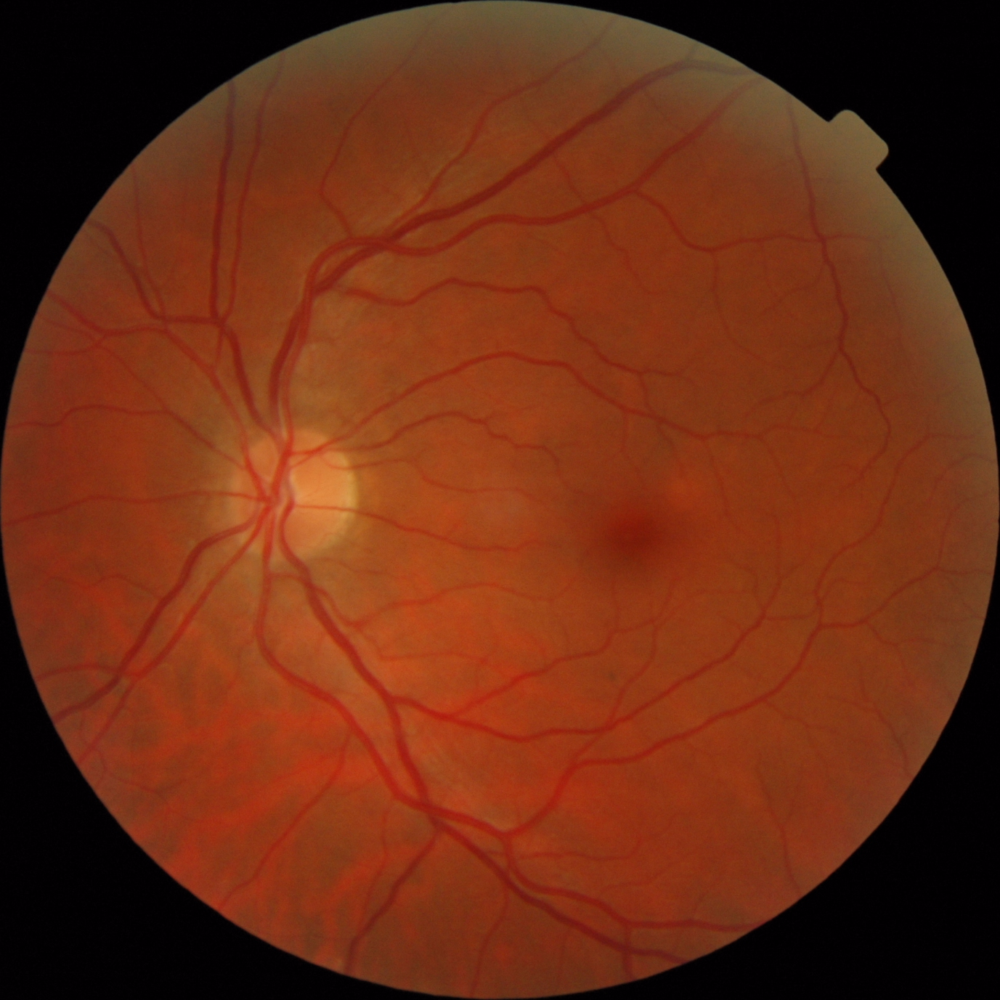

In [2]:
img = Image.open('../../data/processed//messidor/20051020_63337_0100_PP.tif')
#img = Image.open('../../data/raw/DRIVE/training/images/36_training.tif')
#img = Image.open('../../data/processed/eyepacs/10194_left.jpeg')
#img.thumbnail([1024, 1024])
#img.thumbnail([512, 512])

#Y, _, _ = img.convert('YCbCr').split()
# , Y, _ = img.split()
Y = color.rgb2gray(np.array(img))

arr = np.array(Y, dtype=np.float)

arr = np.float32(Y)
black = threshold_otsu(arr)
black = arr < black

img

(1377, 1377) (1377, 1377) (1377, 1377)


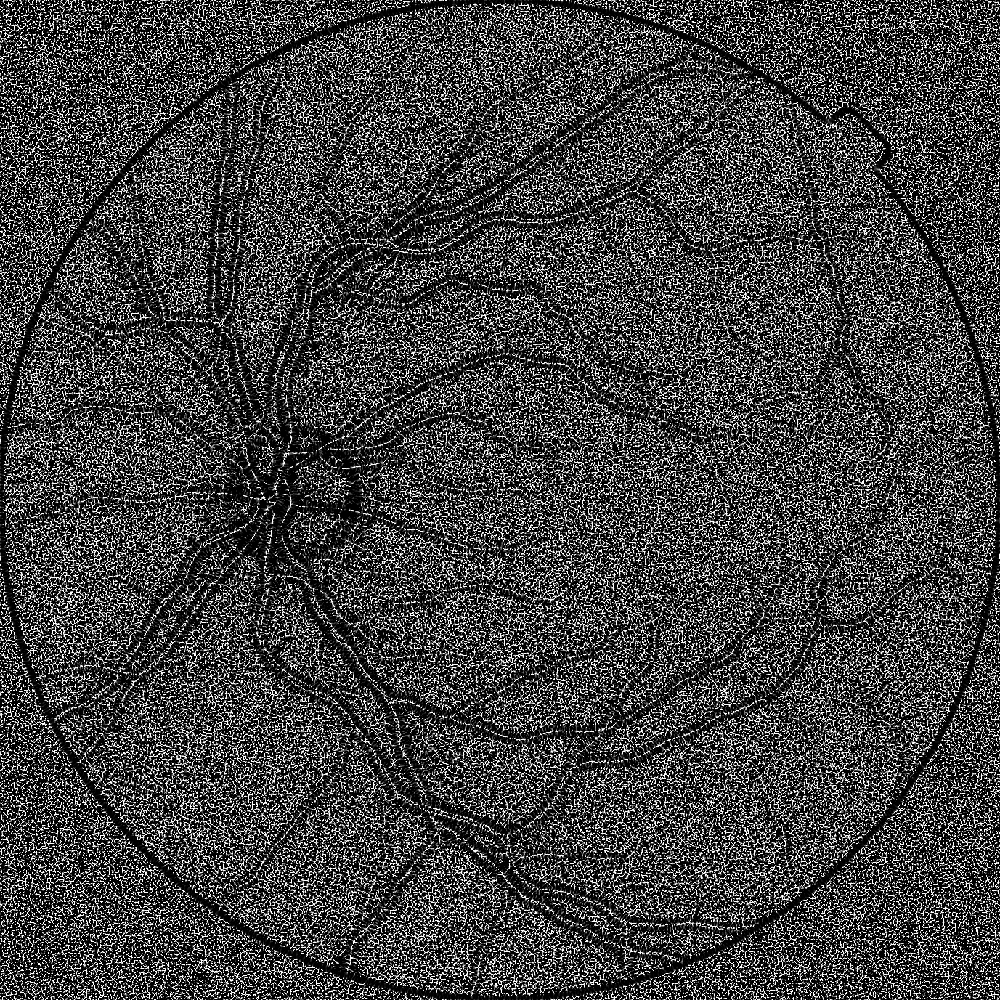

In [3]:
def extend_mask(mask, extend_by=1):
    for _ in range(extend_by):
        # Gradient is true at edge of mask
        m_dx, m_dy = [deriv.astype(bool) for deriv in np.gradient(mask*1.0)]
        mask = np.bitwise_or(mask, np.bitwise_or(m_dx, m_dy))
    return mask

def compute_curvature(img, deriv='gaussian'):
    # http://www0.cs.ucl.ac.uk/staff/S.Arridge/teaching/ndsp/imcurvature.m
    # Note: Individual derivatives might be exchanged, doesn't matter for curvature though!
    deriv = 'gaussian'
    if deriv == 'gaussian':
        sigma=1
        img_dx = ndimage.gaussian_filter(arr, order=[1,0], sigma=sigma, )
        img_dy = ndimage.gaussian_filter(arr, order=[0,1], sigma=sigma)
        img_dxx = ndimage.gaussian_filter(arr, order=[2,0], sigma=sigma)
        img_dyy = ndimage.gaussian_filter(arr, order=[0,2], sigma=sigma)
        img_dxy = ndimage.gaussian_filter(arr, order=[1,1], sigma=sigma)
        img_dyx = img_dxy
    else:
        sobel = 1/8 * np.array([-1,0,1,-2,0,2,-1,0,1]).reshape(3,3)
        img_dx = ndimage.convolve(arr, sobel)
        img_dy = ndimage.convolve(arr, sobel.T)
        img_dxx = ndimage.convolve(img_dx, sobel)
        img_dyy = ndimage.convolve(img_dy, sobel.T)
        img_dxy = ndimage.convolve(img_dx, sobel.T)
        img_dyx = ndimage.convolve(img_dy, sobel)

    gradient_magnitude = np.sqrt(img_dx**2 + img_dy**2)
    curvature = 1.0/gradient_magnitude

    invalid = (arr <= 0.0) | (gradient_magnitude == 0.0)
    curvature[invalid] = 0.0

    # mask is true where grad is possibly zero
    mask = np.zeros_like(invalid, dtype=bool)
    mask[invalid] = True

    #mask1 = extend_mask(mask)
    mask2 = extend_mask(mask, extend_by=2)

    curvature = img_dy**2 * img_dxx - img_dx * (img_dxy  + img_dyx) * img_dy + img_dx**2 * img_dyy
    curvature[~mask2] = curvature[~mask2] / gradient_magnitude[~mask2]**3
    curvature[mask2] = 0.0
    
    return curvature.clip(0,1)

curvature = compute_curvature(arr, deriv='gaussian')
print(curvature.shape, arr.shape, black.shape)
#curvature[black] = 0.0
Image.fromarray((curvature*255.0)).convert('RGB')


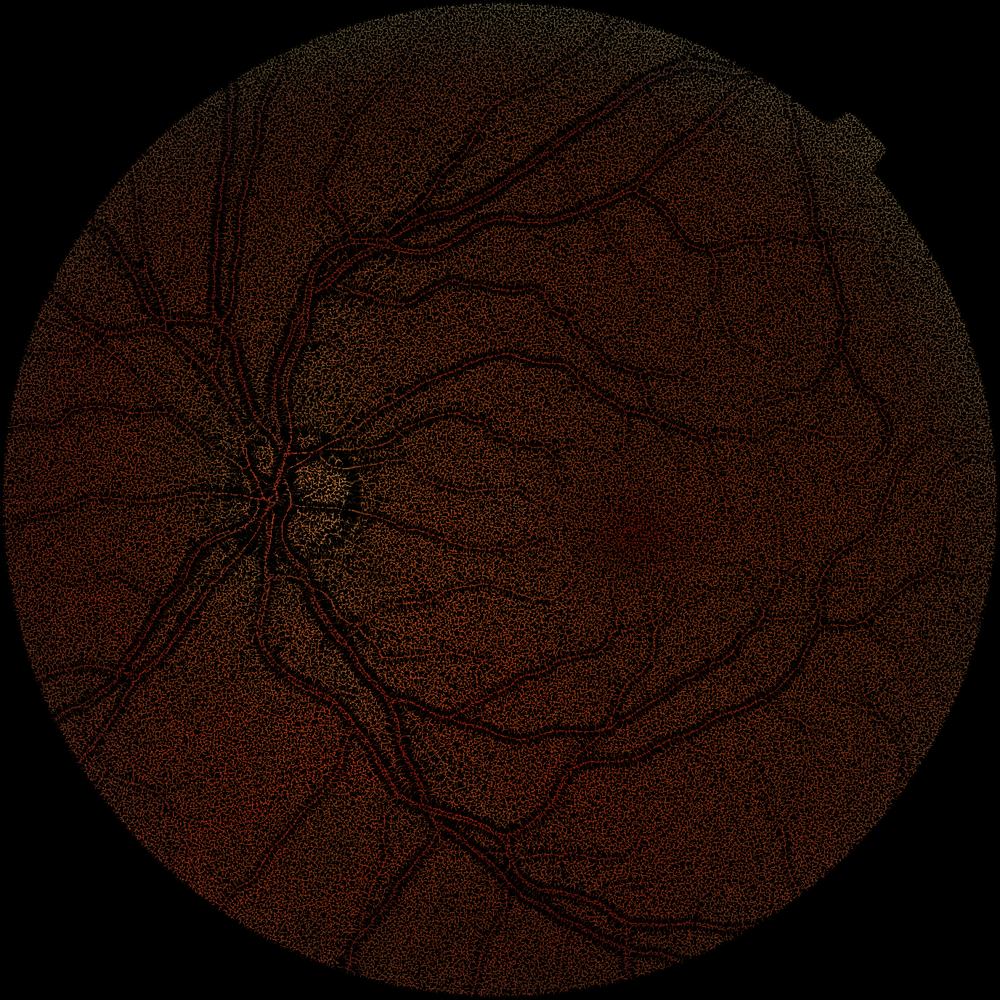

In [4]:
ImageChops.multiply(img, Image.fromarray((curvature)*255.0).convert('RGB'))

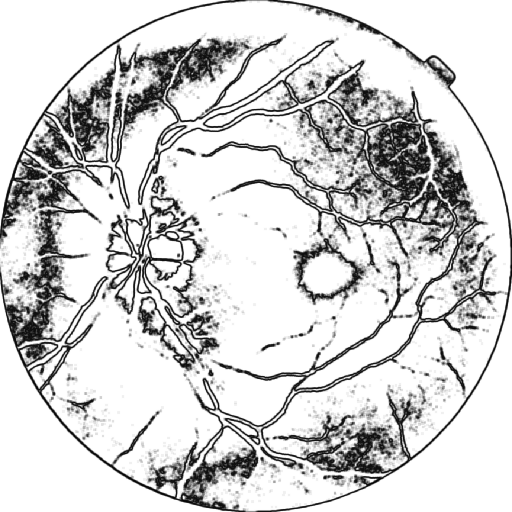

In [5]:
@numba.stencil(neighborhood=((-3, 3),(-3,3)), cval=-42.0)
def entropy_kernel(hist):
    # First compute local probabilities (disc. using passed bins)
    count = np.zeros(8)
    # todo: exclude middle?
    it = np.array([-3,-2,-1,0, 1,2,3])
    for i in it:
        for j in it:
            count[hist[i,j]] += 1

    probs = count / count.sum() # normalize
    
    # Now compute entropy.
    entropy = 0.0
    for i in it:
        for j in it:      
            p = probs[hist[i,j]]
            log_p = np.log(p)
            entropy += -1 * p * log_p    
    return entropy

def compute_entropy(arr):
    num_bins=8
    # computed over all training examples of messidor dataset
    probabilities = np.array([2.14666701e-01, 7.53968572e-02, 3.29558442e-01, 2.77342253e-01,
        8.88463917e-02, 1.17787479e-02, 2.09750599e-03, 3.13101494e-04])
    edges = np.array([  0.   ,  31.875,  63.75 ,  95.625, 127.5  , 159.375, 191.25 ,
        223.125, 255.   ])/255.0

    
    # Reflect pad for better stability at borders
    pad_width = 3
    arr = np.pad(arr, pad_width=pad_width, mode='reflect')
    
    hist = np.digitize(arr, edges, right=True) #- 1
    entr = entropy_kernel(hist)
    
    # Remove padding
    entr = entr[pad_width:-pad_width, pad_width:-pad_width]
    
    # Fiannly use a Gaussian low pass filter to remove small elements
    entr = ndimage.gaussian_filter(entr, 0.5, truncate=3)
    # Normalize to (0,1)
    entr = entr/entr.max()
    
    # Make sure the invalid constant padding is removed!
    assert(entr.min() >= 0.0)
    
    return entr

entr = compute_entropy(arr)
#entr[black] = 1.0
Image.fromarray((1-entr)*255).convert('RGB').resize((512,512))

In [6]:
import time 

@numba.jit(nopython=True, parallel=True)
def get_neighbour_distance(size_sqrt=7):
    assert(size_sqrt % 2 == 1)
    size = size_sqrt**2
    d = np.zeros(size).reshape(size_sqrt, size_sqrt)
    center = size_sqrt//2
    #d[center][center] = 0.0 # center
    for i in range(1):
        for j in range(1):
            d[center+i][center+j] = (i**2 + j**2)**0.5
            d[center+i][center-j] = (i**2 + j**2)**0.5
            d[center-i][center+j] = (i**2 + j**2)**0.5
            d[center-i][center-j] = (i**2 + j**2)**0.5
    #d = np.zeros(size).reshape(size_sqrt, size_sqrt)
    #d[center][center] = 1.0
    d = np.exp(-d)
    return d

@numba.stencil(neighborhood=((-1, 1),(-1,1)), standard_indexing=('neighborhood',))
def uniq_kernel(feature_map, neighborhood):
    feature_center = feature_map[0,0]
    uniqueness = 0.0
    for i in range(3):
        for j in range(3):
            feature_dist = np.abs(feature_center - feature_map[-1+i,-1+j])
            uniqueness += neighborhood[i,j] * feature_dist
    return uniqueness
    
# TODO: Change neighborhood!
def uniqueness(feature_map):
    neighborhood = get_neighbour_distance(size_sqrt=3)
    uniq = uniq_kernel(feature_map, neighborhood)
    return uniq/uniq.max()
   
start = time.perf_counter()
uniq = uniqueness(curvature.clip(0,1))
end = time.perf_counter()
end - start

1.0979678650001006

0.0 0.30546812560689945 1.0


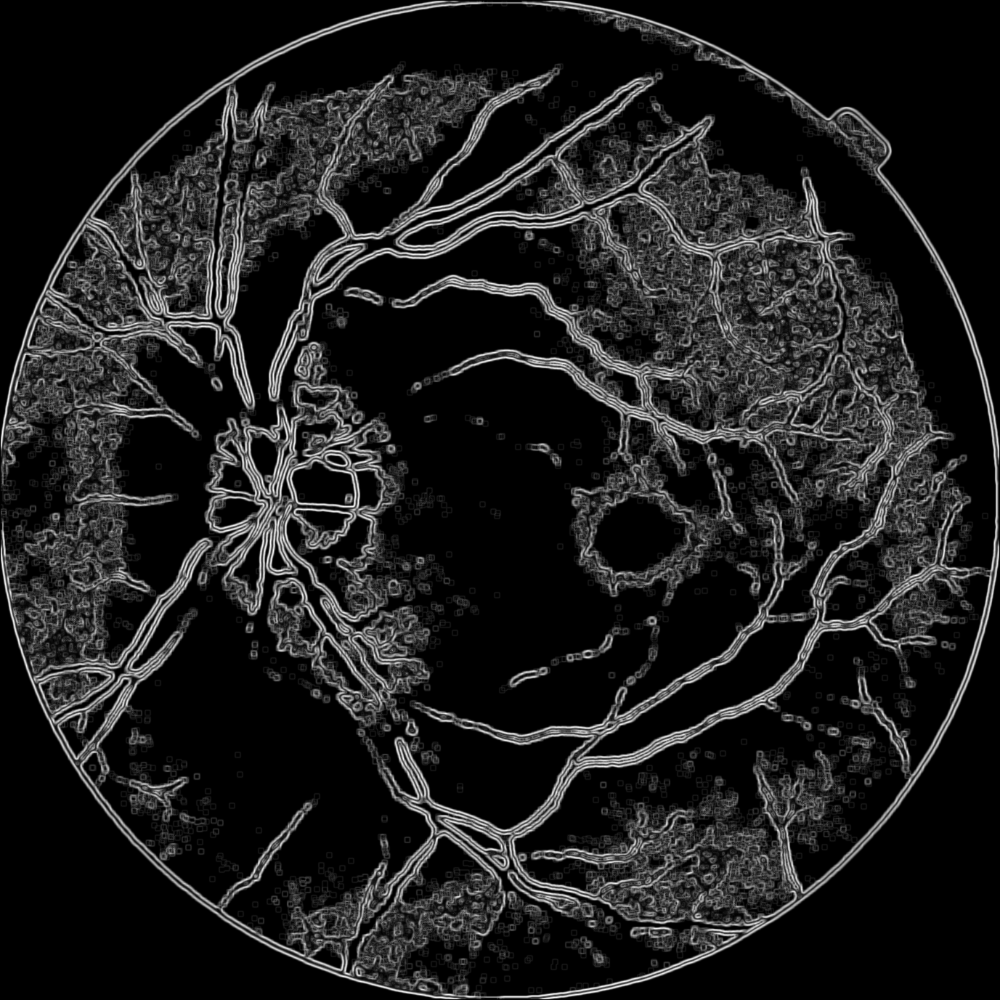

In [7]:
print(uniq.min(), uniq.mean(), uniq.max())
Image.fromarray((uniqueness(1-entr))*255).convert('RGB')

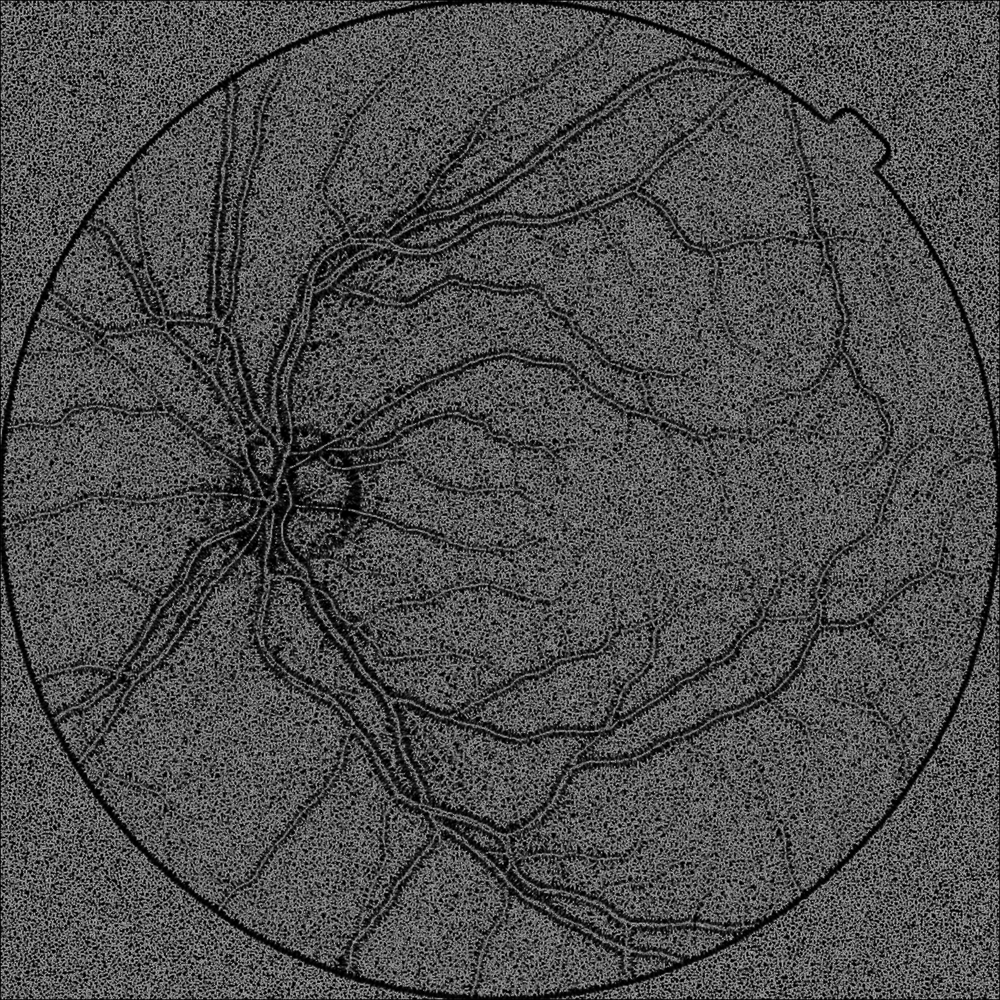

In [8]:
uniq = uniqueness(curvature.clip(0,1))
uniq.min(), uniq.max(), curvature.min(), curvature.max()/255
Image.fromarray(uniq*255).convert('RGB')

In [9]:
start = time.perf_counter()
curvature = compute_curvature(arr)
entropy = compute_entropy(arr)
uniq_curv = uniqueness(curvature) 
uniq_entr =  uniqueness(1.0-entr)
end = time.perf_counter()
end - start

3.996895267000582

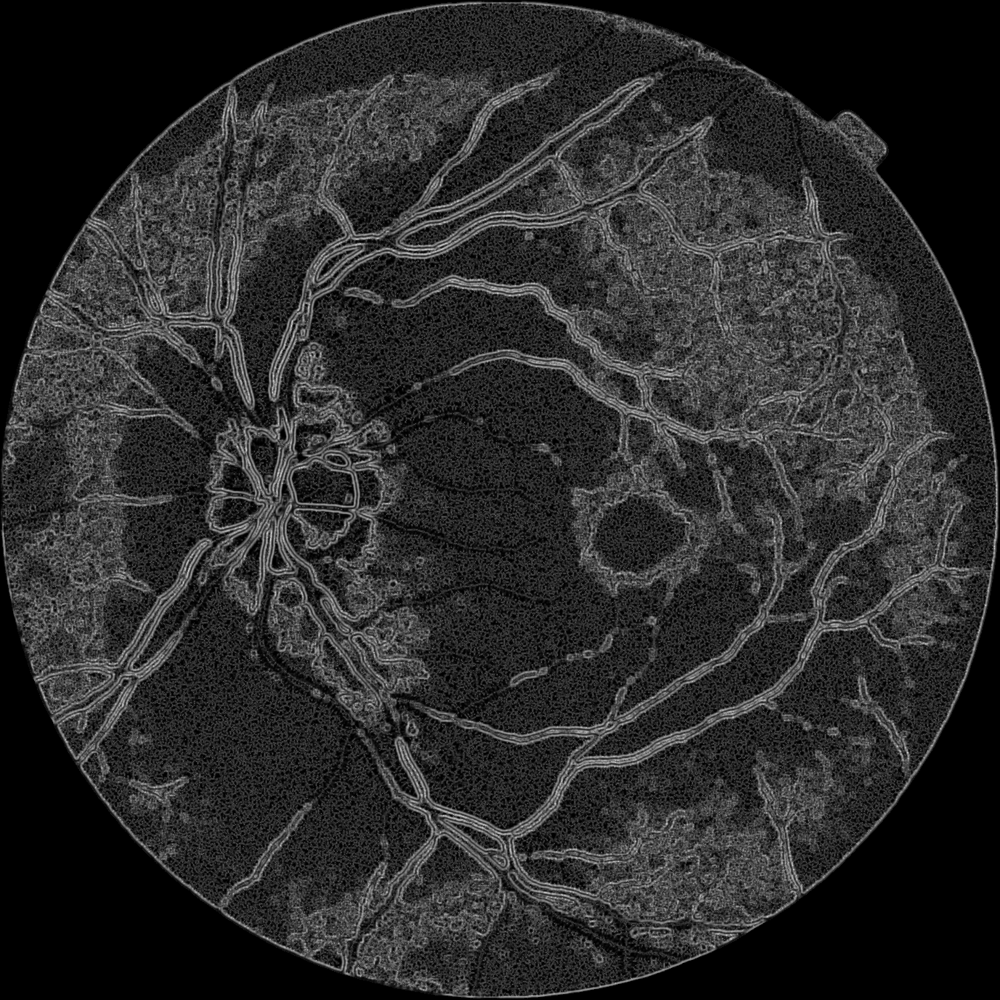

In [10]:
sal = 0.4 * uniq_curv + 0.6 * uniq_entr
sal = (sal - sal.min())/sal.max()
sal[black] = 0.0
sal_img =Image.fromarray((sal)*255.0).convert('RGB')
sal_img

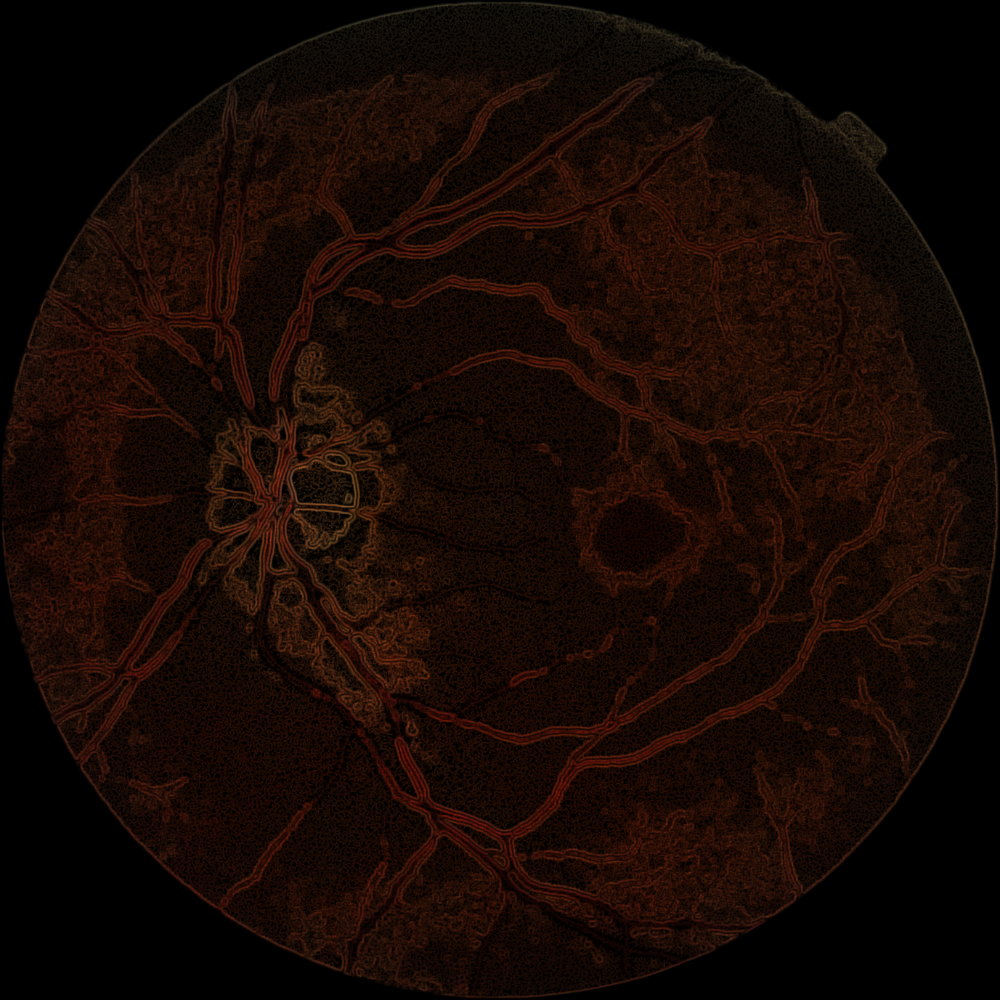

In [11]:
ImageChops.multiply(img, sal_img)

In [12]:
assert(False) # dont rerun!
from pathlib import Path
import os
# Copy paste from dataset
# only use training data for histograms!

path = '../../data/processed/messidor/'
seed=19534
image_suffixes = ['jpg', 'jpeg', 'tif', 'ppm', 'png']        
full_filename = lambda f: os.path.abspath(os.path.join(path, f))
is_image = lambda f: any([f.endswith(suff) for suff in image_suffixes])

filenames = [full_filename(f) for f in os.listdir(path) if is_image(f)]
random.Random(seed).shuffle(filenames)

size = int(np.ceil(0.8 * len(filenames)))
filenames = filenames[:size]
len(filenames)

AssertionError: 

In [ ]:
messidor_dir = Path('../../data/processed//messidor/')
total_count = np.zeros(256, dtype=np.uint64)

for i, img_path in enumerate(filenames):
    if i % 96 == 0 :
        print("Iteration {}/960.".format(i+1))
    img = Image.open(img_path).convert('YCbCr').split()[0]    

    val, counts = np.unique(np.array(img), return_counts=True)
    total_count[val] += counts.astype(np.uint64)

values = np.arange(0,255+1)
hist, edges = np.histogram(values, weights=total_count, bins=8)
hist/hist.sum(), edges